### Bibliotecas

In [13]:
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime

### Parâmetros

In [30]:
arquivo_mapardar = '/Users/marcelofernandes/Library/CloudStorage/GoogleDrive-marcelo.fernandes@alumni.usp.br/.shortcut-targets-by-id/1M--OnzbTYagrNv5Ss9fjWlBxCMmasz-Y/10_Mestrado_2021_Marcelo Fernandes/4_Códigos/maparadar.csv'

my_crs = 'EPSG:4326' # Verificar em EPSG.io um projeção que te dê o resultado em metros

pesquisa_OD = '/Users/marcelofernandes/Library/CloudStorage/GoogleDrive-marcelo.fernandes@alumni.usp.br/.shortcut-targets-by-id/1M--OnzbTYagrNv5Ss9fjWlBxCMmasz-Y/10_Mestrado_2021_Marcelo Fernandes/8_Dados/Pesquisa OD 2017/OD-2017/Mapas-OD2017/Shape-OD2017/Zonas_2017_region.shp'
plt.style.use('ggplot')


### Importação e criação do GDF

In [18]:
# Ler o arquivo CSV de entrada
df = pd.read_csv(arquivo_mapardar, header=None, names=['Longitude', 'Latitude', 'TipoCompleto'])

# Garantir que todas as colunas sejam tratadas como strings
df['TipoCompleto'] = df['TipoCompleto'].astype(str)

# Dividir a coluna 'TipoCompleto' na parte antes do hífen e o resto
df[['Tipo', 'VelocidadeCompleta']] = df['TipoCompleto'].str.split(' - ', expand=True)

# Garantir que a coluna 'VelocidadeCompleta' seja tratada como string
df['VelocidadeCompleta'] = df['VelocidadeCompleta'].astype(str)

# Extrair a velocidade após o '@' na coluna 'VelocidadeCompleta'
df['Velocidade'] = df['VelocidadeCompleta'].str.extract(r'@(\d+)$')[0]

# Adicionar as colunas de data e hora de atualização
data_atualizacao = '25/05/2024'
hora_atualizacao = '18:59'

df['Data de Atualização'] = data_atualizacao
df['Hora de Atualização'] = hora_atualizacao

# Manter apenas as colunas necessárias e reorganizá-las
df = df[['Latitude', 'Longitude', 'Tipo', 'Velocidade', 'Data de Atualização', 'Hora de Atualização']]

# Exibir o DataFrame resultante
print(df)

        Latitude  Longitude        Tipo Velocidade Data de Atualização  \
0     -19.945982 -44.058251  Radar Fixo         30          25/05/2024   
1     -20.497442 -54.628774  Radar Fixo         30          25/05/2024   
2     -20.496188 -54.646443  Radar Fixo         30          25/05/2024   
3      -8.063943 -34.871705  Radar Fixo         30          25/05/2024   
4     -19.908390 -44.091283  Radar Fixo         30          25/05/2024   
...          ...        ...         ...        ...                 ...   
38212 -22.259199 -54.821716     Lombada          0          25/05/2024   
38213 -22.259227 -54.825030     Lombada          0          25/05/2024   
38214 -28.672509 -53.604210     Lombada          0          25/05/2024   
38215 -28.649514 -53.630577     Lombada          0          25/05/2024   
38216 -28.650318 -53.630243     Lombada          0          25/05/2024   

      Hora de Atualização  
0                   18:59  
1                   18:59  
2                   18:59  

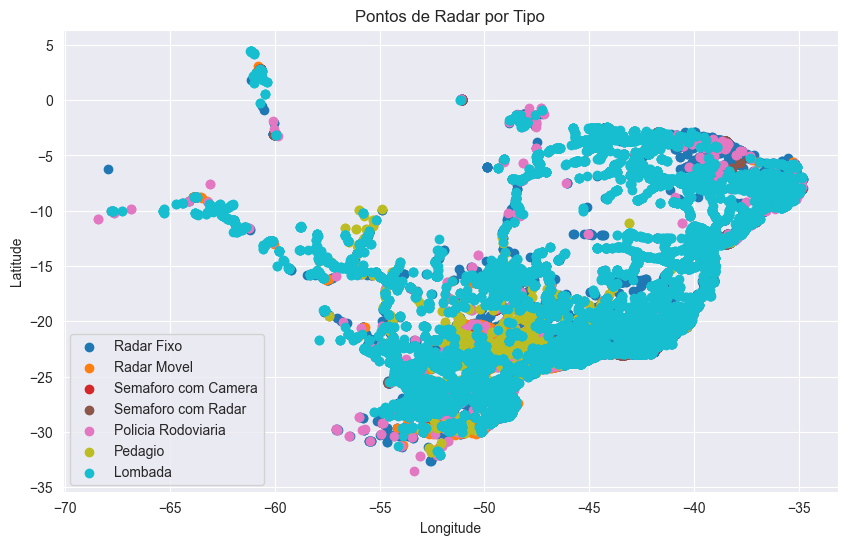

In [19]:
# Plotar os pontos
plt.figure(figsize=(10, 6))

# Obter lista de tipos únicos
tipos_unicos = df['Tipo'].unique()

# Definir um dicionário de cores para os tipos
cores = plt.get_cmap('tab10', len(tipos_unicos))

# Plotar cada tipo com uma cor diferente
for i, tipo in enumerate(tipos_unicos):
    subset = df[df['Tipo'] == tipo]
    plt.scatter(subset['Longitude'], subset['Latitude'], label=tipo, color=cores(i))

# Adicionar legendas e título
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Pontos de Radar por Tipo')
plt.legend()

# Mostrar o gráfico
plt.show()

In [38]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point

# Criar uma geometria Point a partir das colunas Latitude e Longitude
geometry = [Point(xy) for xy in zip(df['Longitude'], df['Latitude'])]

# Criar um GeoDataFrame a partir do DataFrame e da geometria
gdf_maparadar = gpd.GeoDataFrame(df, geometry=geometry)

# Opcional: definir o CRS (Sistema de Referência de Coordenadas)
gdf_maparadar.crs = my_crs

gdf_maparadar.explore(
    column="Tipo",  # make choropleth based on "BoroName" column
    tooltip="Tipo",  # show "BoroName" value in tooltip (on hover)
    popup=True,  # show all values in popup (on click)
    tiles="CartoDB positron",  # use "CartoDB positron" tiles
    cmap="Set1",  # use "Set1" matplotlib colormap
    style_kwds=dict(color="black"),  # use black outline
)

In [39]:
gdf_maparadar.to_file("vel_atual_maparadar.geojson", driver="GeoJSON")

In [40]:
pwd

'/Users/marcelofernandes/PycharmProjects/SP_urban_flooding'

### Carregar Pesquisa OD do Metro

In [32]:
import geopandas as gpd
# Read the shapefile
gdf_OD = gpd.read_file(pesquisa_OD)

# Verifica o sistema de coordenadas
gdf_OD.crs

# Atribuição do esquema de projeção
gdf_OD = gdf_OD.to_crs(my_crs)
#edges2 = edges2.to_crs(my_crs)

# Filtrando para o munícipio de São Paulo
gdf_indices=gdf_OD.index[gdf_OD['NomeMunici']=='São Paulo']
gdf_OD_SP = gdf_OD.loc[gdf_indices]

# Obtendo os centroides
gdf_OD_SP["centroid"] = gdf_OD_SP["geometry"].centroid
gdf_OD_SP['centroid'].explore(
#                            column = "NumeroZona",
#                            tooltip = "NumeroZona",
#                            popup = True,
#                            tiles = "CartoDB dark_matter",
#                            cmap = "inferno_r"
                            )

/var/folders/8y/8z4lzw294m5c0kf05d8ww4r00000gn/T/ipykernel_8725/678213920.py:17: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.


